In [7]:
import numpy
import scipy
import matplotlib.pyplot as plt
import sklearn
import librosa
import librosa.display as ld
import mir_eval
import IPython.display
plt.rcParams['figure.figsize'] = (14, 4)

[&larr; Back to Index](index.html)

# K-Means Clustering

Sometimes, an unsupervised learning technique is preferred.  Perhaps you do not have access to adequate training data, or perhaps the training data's labels are not completely clear.  Maybe you just want to quickly sort real-world, unseen, data into groups based on its feature similarity.

In such cases, clustering is a great option!

Play the audio file:

In [8]:
IPython.display.Audio('snippets/NoddingOff.wav')

Load the audio file into an array.

In [4]:
x, fs = librosa.load('snippets/NoddingOff.wav')
print(fs)

22050


Plot audio signal:

/tmp/ipykernel_131936/3476714270.py:1: FutureWarning: Pass sr=22050 as keyword args. From version 0.10 passing these as positional arguments will result in an error
  ld.waveshow(x, fs)


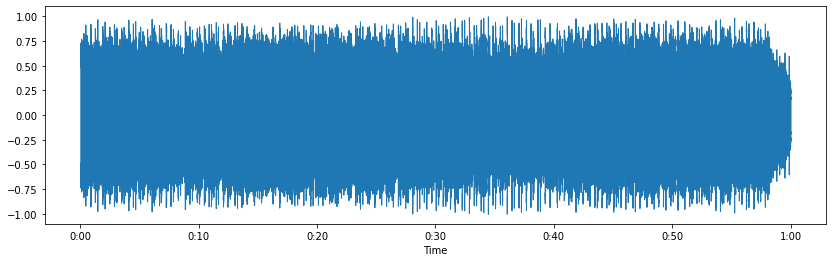

In [9]:
ld.waveshow(x, fs)

## Onset Detection

Detect onsets:

In [11]:
onset_frames = librosa.onset.onset_detect(y=x, sr=fs, delta=0.04, wait=4)
onset_times = librosa.frames_to_time(onset_frames, sr=fs)
onset_samples = librosa.frames_to_samples(onset_frames)

Listen to detected onsets:

In [12]:
x_with_beeps = mir_eval.sonify.clicks(onset_times, fs, length=len(x))
IPython.display.Audio(x + x_with_beeps, rate=fs)

## Feature Extraction

Let's compute the zero crossing rate and energy for each detected onset.

Plot the zero crossing rate:

In [14]:
def extract_features(x, fs):
    zcr = librosa.zero_crossings(x).sum()
    energy = scipy.linalg.norm(x)
    return [zcr, energy]

In [15]:
frame_sz = fs*0.090
features = numpy.array([extract_features(x[i:int(i+frame_sz)], fs) for i in onset_samples])
print(features.shape)

(289, 2)


## Feature Scaling

Scale the features (using the scale function) from -1 to 1.

In [16]:
min_max_scaler = sklearn.preprocessing.MinMaxScaler(feature_range=(-1, 1))
features_scaled = min_max_scaler.fit_transform(features)
print(features_scaled.shape)
print(features_scaled.min(axis=0))
print(features_scaled.max(axis=0))

(289, 2)
[-1. -1.]
[1. 1.]


Plot the features.

Text(0, 0.5, 'Spectral Centroid (scaled)')

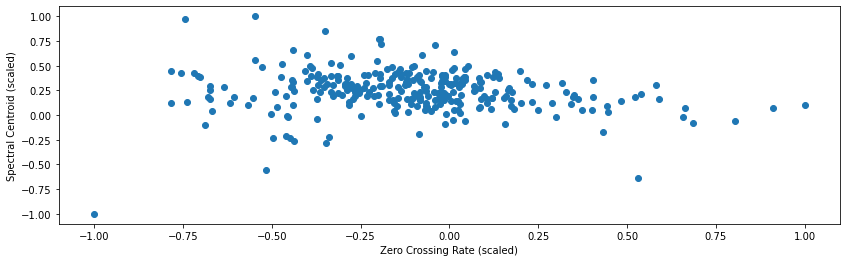

In [17]:
plt.scatter(features_scaled[:,0], features_scaled[:,1])
plt.xlabel('Zero Crossing Rate (scaled)')
plt.ylabel('Spectral Centroid (scaled)')

## Using K-Means

Time to cluster! Let's initialize the algorithm to find three clusters.

In [18]:
model = sklearn.cluster.KMeans(n_clusters=2)
labels = model.fit_predict(features_scaled)
print(labels)

[1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 0 0 1 1 0
 1 1 0 0 1 1 0 0 1 1 1 0 0 0 1 0 1 1 1 1 0 1 1 0 0 0 1 1 0 0 1 1 1 1 1 1 0
 1 1 0 1 1 1 0 1 1 1 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1
 1 1 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 0 0 0 1 1 0 0 1 0 0 0 1 1 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 1 1 1 1 1 0 1 0 0 0 0 0 0 1 1 0 1
 1 1 0 0 0 0 0 1 1 0 0 1 0 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0 1 1 1 1 1 0 1 1 1
 0 1 0 0 0 1 1 1 1 1 0 1 0 0 0 1 1 0 0 1 1 1 0 0 0 0 0 1 0 0]


Plot the results.

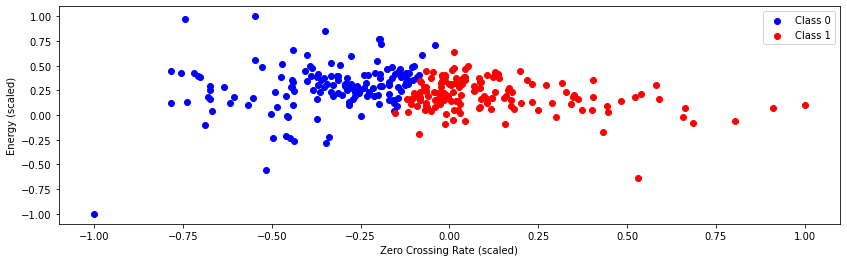

In [19]:
plt.scatter(features_scaled[labels==0,0], features_scaled[labels==0,1], c='b')
plt.scatter(features_scaled[labels==1,0], features_scaled[labels==1,1], c='r')
plt.xlabel('Zero Crossing Rate (scaled)')
plt.ylabel('Energy (scaled)')
plt.legend(('Class 0', 'Class 1'))

Listen to onsets assigned to Class 0:

In [20]:
x_with_beeps = mir_eval.sonify.clicks(onset_times[labels==0], fs, length=len(x))
IPython.display.Audio(x + x_with_beeps, rate=fs)

Class 1:

In [21]:
x_with_beeps = mir_eval.sonify.clicks(onset_times[labels==1], fs, length=len(x))
IPython.display.Audio(x + x_with_beeps, rate=fs)

## Affinity Propagation

In scikit-learn, other clustering algorithms such as *affinity propagation* can cluster without defining the number of clusters beforehand.

All we need to do is swap out `KMeans` for `AffinityPropagation`:

In [25]:
model = sklearn.cluster.AffinityPropagation()
labels = model.fit_predict(features_scaled)
print(labels)

[ 5 11  1  0  2  0 10  1  3 11  2 10 13  8 12 12  7  2  1  4 11  2 13  0
 13 16  0  5 13  3 11 10  2  4 10 13  2  5  5  0 12 16 16  4  2  5 10  9
  2  4 11 13  8 16 13 13 16  4  5 16  4 12 10 10  5  2  6 10 10 11 11  7
 10 11  7  7  8  7  1  1 10  3  7 10 10 10 11  8  7 10 11 10  9  1  5  5
  3 10 10  7  7  5  8  7 10 11 10  9  1  5 10  1 13 11 11 10 10  7 11  7
 10 11  9  1  1  8  1  5  1  1 13  5  2  2  4  2 12 13 13 14 14 13 12 12
  0 13 13  0  4  4 12  4  0 16  2 14 15  2 14 14  0 13 15 15  6 17 15 17
  4  0 14 15 16 14 17 17 13  0 17 15  4 17 17 19 12 12 17 15 13 17 12 14
 11 13  1 12  2  9  4 12 10 11  2  4 10 13 13 13 13  0  2 10 18 12 11  4
  2  6 10 16  2  5  5  5  4  2  0  6 12 10 10  0  2 10  0 16 13 16  0  9
  5  0  6  2 10 10  5  2  2  2 13 13 13 13 13  6 13  3 10  2 10  2 11  2
 13 13 13 13 13  0 13 12 18 12 10  5  2  2 10 16 16 19 19 19 19 19 20 19
 21]


Plot features:

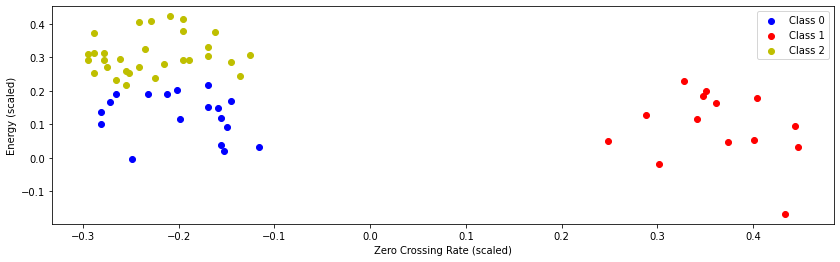

In [26]:
plt.scatter(features_scaled[labels==0,0], features_scaled[labels==0,1], c='b')
plt.scatter(features_scaled[labels==1,0], features_scaled[labels==1,1], c='r')
plt.scatter(features_scaled[labels==2,0], features_scaled[labels==2,1], c='y')
plt.xlabel('Zero Crossing Rate (scaled)')
plt.ylabel('Energy (scaled)')
plt.legend(('Class 0', 'Class 1', 'Class 2'))

Play a beep upon each frame in the same cluster:

Class 0:

In [27]:
x_with_beeps = mir_eval.sonify.clicks(onset_times[labels==0], fs, length=len(x))
IPython.display.Audio(x + x_with_beeps, rate=fs)

Class 1:

In [28]:
x_with_beeps = mir_eval.sonify.clicks(onset_times[labels==1], fs, length=len(x))
IPython.display.Audio(x + x_with_beeps, rate=fs)

Class 2:

In [29]:
x_with_beeps = mir_eval.sonify.clicks(onset_times[labels==2], fs, length=len(x))
IPython.display.Audio(x + x_with_beeps, rate=fs)

[&larr; Back to Index](index.html)